# Example - Dark GW170817

The selection bias term is temporary computed as $\propto H_0^{-3}$ so that the injection file is not needed.

In [15]:
dir_LVK       = "../../data/LVK"
dir_GLADE     = "../../data/GLADE/glade+_GW170817_cutout.hdf5"
dir_GLADE_int = "../../data/GLADE/p_bkg_gauss_smooth_zres5000_smooth30.pkl"

import numpy as np
import healpy as hp
from tqdm import tqdm
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
from CHIMERA.DataGW import DataLVK
from CHIMERA.Likelihood import LikeLVK
from CHIMERA.astro.mass import pdf_FLAT, dummy_mass
from CHIMERA.astro.rate import phi_PL, dummy_rate
from CHIMERA.cosmo import fLCDM
from CHIMERA.utils import misc, plotting
%config InlineBackend.figure_format = "svg"

data_GW_n = "GW170817"
ra4993    = 3.44613079
dec4993   = -0.40812585
z4993     = 0.0091909380476333
errz4993  = 0.0002665372033813657

data_GW = DataLVK(dir_LVK).load(data_GW_n)
data_GW["dL"] /= 1000. # Mpc -> Gpc

GW170817_GWTC-1.hdf5


In [16]:
recipe  = {"data_GW_names":     data_GW_n,
           "data_GW":           data_GW,
           "data_GW_smooth":    0.3,
           "data_GAL_dir":      dir_GLADE,
           "data_GAL_int_dir":  dir_GLADE_int,
           "data_GAL_weights":  "L_K",
           "npix_event":        20,
           "sky_conf":          0.90,
           "nside_list":        [512,256,128,64,32,16,8],
           "z_int_sigma":       5,
           "z_int_res":         300,
           "z_det_range":       [0.01, 0.5],
           "z_int_H0_prior":    [30.,220.],
           "Lcut":              0.02,
           "band":              "K",
           "completeness":      None,
}

In [17]:
like_dark = LikeLVK(model_cosmo = fLCDM, model_mass  = dummy_mass, model_rate  = dummy_rate, **recipe)


grid_H0 = np.linspace(20.,200.,99)
like_H0 = np.zeros_like(grid_H0)


for i in tqdm(range(len(grid_H0))):
    lambda_cosmo["H0"] = grid_H0[i]
    like_H0[i]      = like_dark.compute(lambda_cosmo, lambda_mass, lambda_rate, inspect=True)

  0%|          | 0/99 [00:00<?, ?it/s]/tmp/ipykernel_29131/4203354732.py:10: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  like_H0[i]      = like_dark.compute(lambda_cosmo, lambda_mass, lambda_rate, inspect=True)
100%|██████████| 99/99 [00:09<00:00, 10.30it/s]


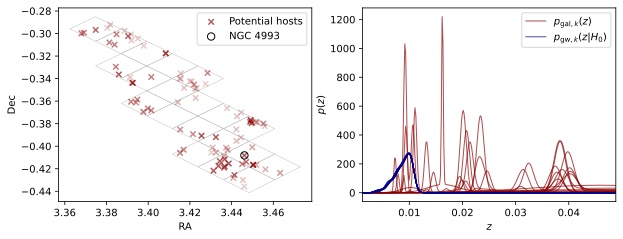

In [18]:
fig, ax = plt.subplots(1,2, figsize=(10,3.5), dpi=150)

plotting.plot_2Dcoring(like_dark, renorm_all=1, iteration=np.abs(grid_H0 - 70).argmin(), ax=ax)
ax[0].scatter(ra4993, dec4993, edgecolors='k', facecolors='none', s=55, lw=1,  label="NGC 4993")
ax[0].legend()

In [19]:
fig, ax = plt.subplots(figsize=(5,3.5), dpi=150)

post_H0 = like_H0 / grid_H0**3  # temporal fix

misc.get_confidence_HDI(post_H0, grid_H0, kde=0.2, ax=ax, color="indigo")
plt.xlabel(r"$H_0$ [km/s/Mpc]")
plt.ylabel(r"$p(H_0)$")
plt.legend()